In [1]:
from google.cloud import bigquery
from google.colab import auth, drive
import os
# Mount to Google Drive if data on Drive
drive.mount('/content/gdrive')
os.chdir('gdrive/My Drive/COMP90089/COMP90089 Team 13')
os.getcwd()

Mounted at /content/gdrive


'/content/gdrive/.shortcut-targets-by-id/1ilKwwgquZsK5UDJS2DgoYs_1OJbWKzYZ/COMP90089 Team 13'

In [2]:
from sklearn.metrics import silhouette_score
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA

import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import warnings

warnings.filterwarnings('ignore')

In [3]:
# Read in data and list the necessary features
df = pd.read_csv('x_ray_and_features_data.csv')

diseases = ['pneumonia', 'tuberculosis', 'bronchitis', 'arthritis', 'fracture', 'lung_cancer', 'scoliosis', 'lung_infection']
mimic_feats = ['diabete', 'age', 'hiv', 'oxygen', 'heart_rate', 'temperature', 'hemoglobin', 'rbc', 'wbc', 'smoke', 'cough']
img_feats = [str(x) for x in range(18)]

In [4]:
# Count the number of patients
dc = df[diseases].apply(pd.Series.value_counts)
dc

,pneumonia,tuberculosis,bronchitis,arthritis,fracture,lung_cancer,scoliosis,lung_infection
0,21069,28282,27564,27861,26978,21277,28902,28103
1,7983,770,1488,1191,2074,7775,150,949


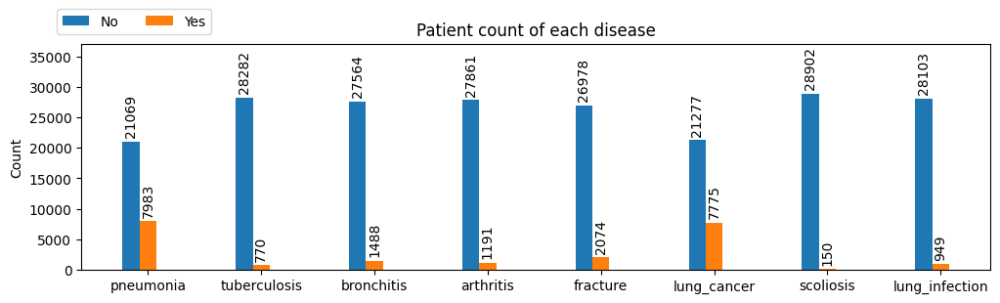

In [24]:
# Plot out the count to see the ratio
_,ax = plt.subplots(figsize=(12,3))
w = 0.15
x = np.arange(len(diseases))
for j,v in enumerate([0,1]):
  offset = w*j
  rects = ax.bar(x+offset, dc.iloc[v], w, label='Yes' if v else 'No')
  ax.bar_label(rects, padding=3, fmt='%.f', rotation=90)
ax.set_xticks(x + w, diseases)
ax.legend(loc='right', ncols=2, bbox_to_anchor=(0.15,1.1))
ax.set_ylabel('Count')
ax.set_ylim(0,37000)
ax.set_title('Patient count of each disease')
plt.show()

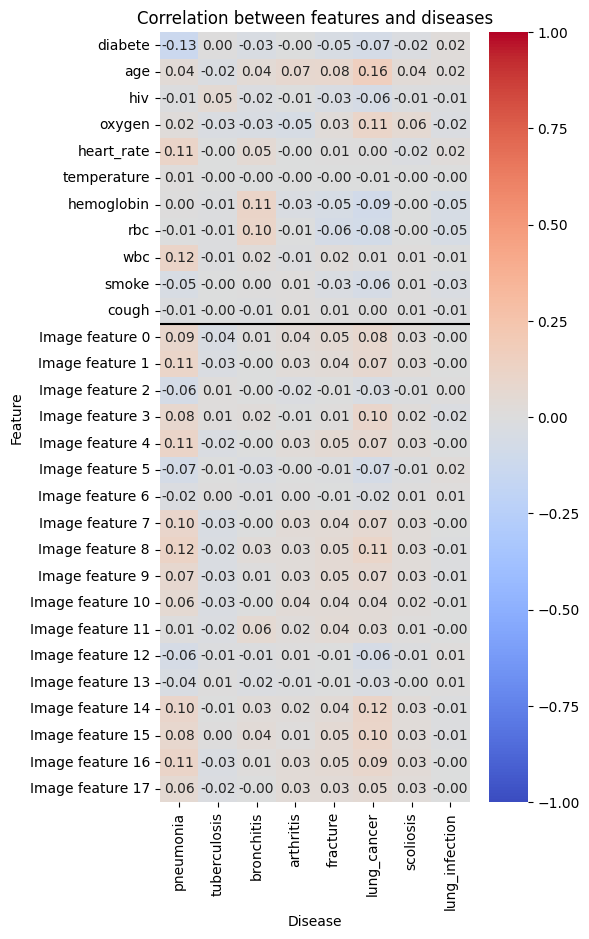

In [ ]:
# Correlation plotting

# Function for formatting label name for better explanation
mdl_fmt = lambda s: f'Image feature {s}' if len(s)<3 else s

# Get the correlation
co = df[mimic_feats+img_feats+diseases].corr()

# Plotting
_,ax = plt.subplots(figsize=(5,10))
sns.heatmap(co.loc[mimic_feats+img_feats,diseases], cmap='coolwarm', vmin=-1, vmax=1, annot=True, fmt=".2f", ax=ax)
ax.set_title('Correlation between features and diseases')
ax.set_xlabel('Disease')
ax.set_ylabel('Feature')
ax.set_yticklabels([mdl_fmt(item.get_text()) for item in ax.get_yticklabels()])
# Draw line to separate the categories
ax.hlines([11], *ax.get_xlim(), colors='black')

plt.show()

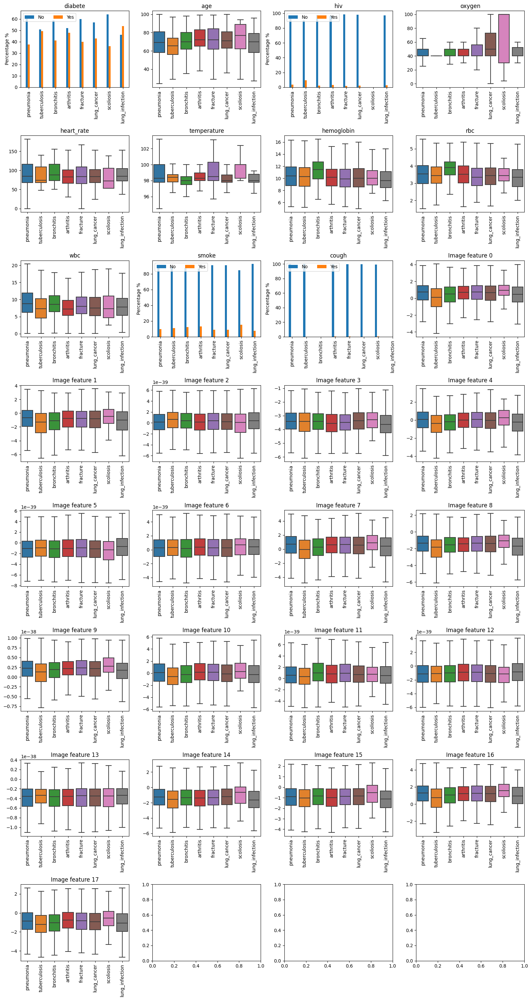

In [ ]:
n = len(mimic_feats+img_feats)
c = 4     # Number of plots per row
w = 0.15  # Width of bars
# Plot out with c plots per row
fig, ax = plt.subplots(n//c + (n%c > 0), c, figsize=(16, 30))

# Plot for each feature
for i,f in enumerate(mimic_feats+img_feats):
  new_df = pd.DataFrame({d:df.apply(lambda x: x[f] if x[d]==1 else np.nan, axis=1) for d in diseases})
  # If binary features, bar plot
  if len(df[f].unique()) == 2:
    cdf = new_df.apply(pd.value_counts).apply(lambda x: x/sum(x)*100, axis=0)
    x=np.arange(len(diseases))
    for j,v in enumerate([0,1]):
      offset = w*j
      rects = ax[i//c, i%c].bar(x+offset, cdf.iloc[v], w, label='Yes' if v else 'No')
      #plt.bar_label(rects, padding=3, fmt='%.f')
    ax[i//c, i%c].set_xticks(x + w, diseases)
    ax[i//c, i%c].legend(loc='upper left', ncols=2)
    ax[i//c, i%c].set_ylabel('Percentage %')
  # Otherwise, box plot the majority of data, no outliers
  else:
    sns.boxplot(new_df, ax=ax[i//c, i%c], showfliers=False)
  ax[i//c, i%c].set_title(mdl_fmt(f))
  ax[i//c, i%c].tick_params(axis='x', labelrotation=90)

plt.tight_layout()
plt.show()

### Do some cluster analysis

100%|██████████| 9/9 [01:47<00:00, 11.91s/it]


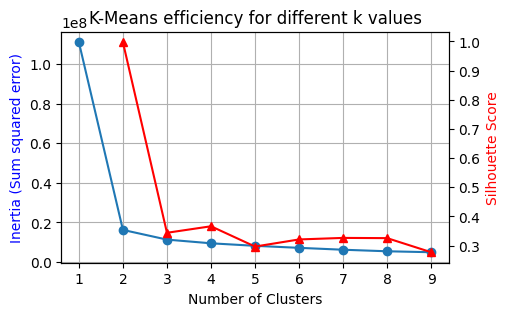

In [ ]:
import tqdm

# Determine the optimal number of clusters using the elbow method
d2 = df[img_feats+mimic_feats]
df_filled = d2.fillna(df.mean())

inertia = []
sil = []
n = 10
# Perform Kmeans, get SSE and silhouette score
for k in tqdm.trange(1, n):
    kmeans = KMeans(n_clusters=k, n_init = 10, max_iter = 300, random_state=0)
    kmeans.fit(df_filled)
    inertia.append(kmeans.inertia_)
    # No silhoulette for k=1
    if k>1: sil.append(silhouette_score(df_filled, kmeans.labels_))

# Plotting
_,ax = plt.subplots(figsize=(5, 3))
axr = ax.twinx()
ax.plot(range(1, n), inertia, marker='o', linestyle='-')
axr.plot(range(2, n), sil, marker='^', linestyle='-',color='red')
ax.set_xlabel('Number of Clusters')
ax.set_ylabel('Inertia (Sum squared error)', color='blue')
axr.set_ylabel('Silhouette Score', color='red')
ax.set_title('K-Means efficiency for different k values')
ax.grid()
plt.show()

In [ ]:
# Perform k-means clustering for k=2
kmeans_2 = KMeans(n_clusters=2, n_init = 10, max_iter = 300, random_state=0)
clusters_2 = kmeans_2.fit_predict(df_filled)

### Visualize the resulting clusters

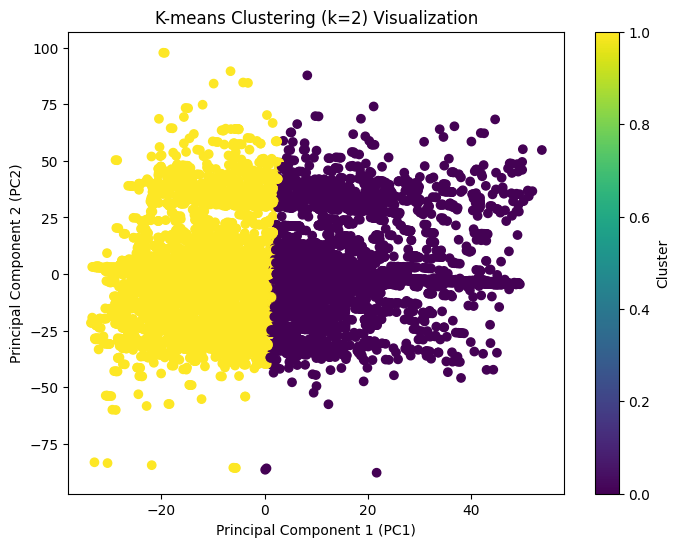

In [ ]:

# Apply PCA to reduce the data to 2 dimensions
pca = PCA(n_components=2)
reduced_features = pca.fit_transform(df_filled)

# Create a new DataFrame with the reduced features and cluster labels
reduced_df = pd.DataFrame(data=reduced_features, columns=['PC1', 'PC2'])
reduced_df['Cluster'] = clusters_2

# Create a scatter plot to visualize the clusters
plt.figure(figsize=(8, 6))
plt.scatter(reduced_df['PC1'], reduced_df['PC2'], c=reduced_df['Cluster'], cmap='viridis')
plt.title('K-means Clustering (k=2) Visualization')
plt.xlabel('Principal Component 1 (PC1)')
plt.ylabel('Principal Component 2 (PC2)')
plt.colorbar(label='Cluster')
plt.show()





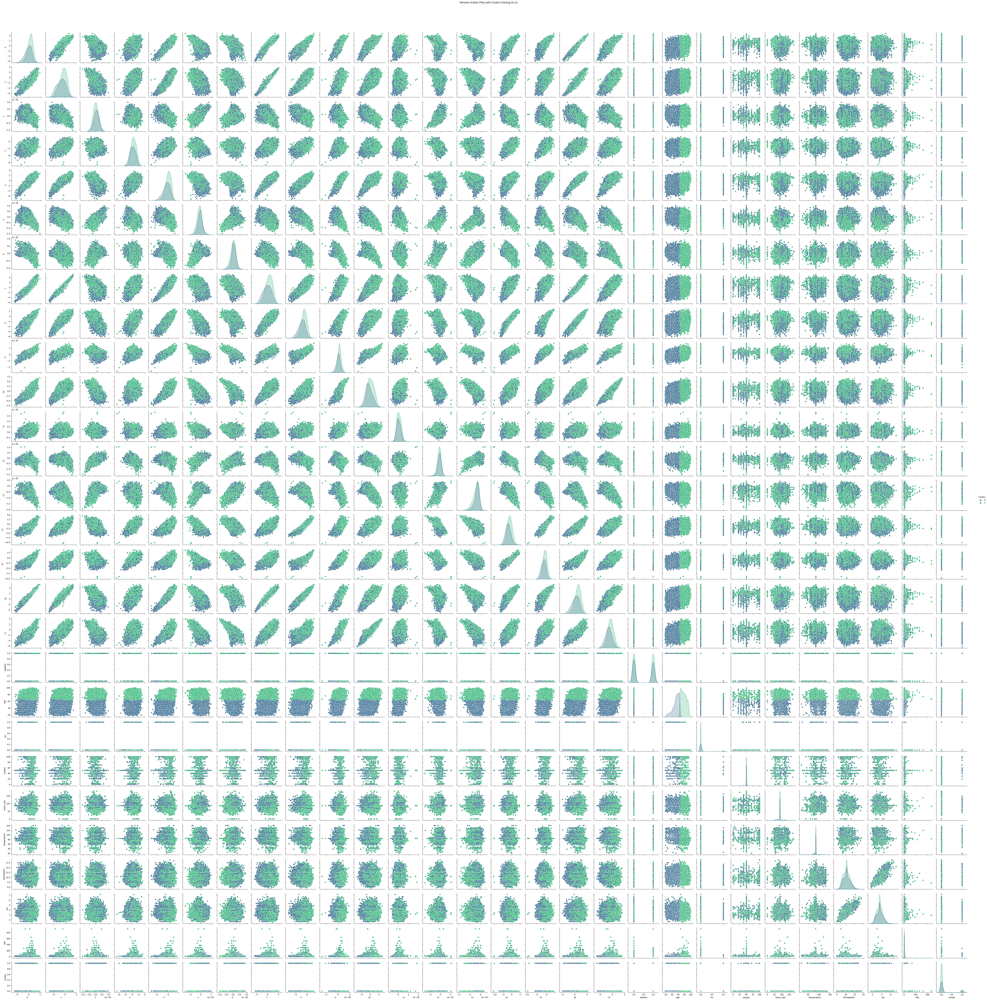

In [ ]:
# Add the 'clusters_2' column to the selected features DataFrame
df_filled['Cluster'] = clusters_2

# Create pairwise scatter plots colored by cluster labels
sns.pairplot(df_filled, hue='Cluster', palette='viridis', markers=['o', 's'], diag_kind='kde')
plt.suptitle('Pairwise Scatter Plots with Cluster Coloring (k=2)', y=1.02)
plt.show()